In [1]:
import os
import json
import torch
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.path import Path
from torchvision.transforms import v2 as T
from transformers import AutoImageProcessor
from transformers import DetrImageProcessor, DetrForObjectDetection
import numpy as np

In [7]:
DATASET_PATH = 'dataset/'
TRAIN_IMG = 'dataset/train/IMG'
TRAIN_JSON = 'dataset/train/JSON'
VAL_IMG = 'dataset/val/IMG'
VAL_JSON = 'dataset/val/JSON'
OUTPUT = 'output'
MODEL = 'detr/detr-r50-e632da11.pth'

In [8]:
# Check if paths exist
import os 
print(os.path.exists(DATASET_PATH))
print(os.path.exists(TRAIN_IMG))
print(os.path.exists(TRAIN_JSON))
print(os.path.exists(VAL_IMG))
print(os.path.exists(VAL_JSON))
print(os.path.exists(OUTPUT))
print(os.path.exists(MODEL))

True
True
True
True
True
True
True


#### Train Model


In [9]:
!python detr/main.py\
    --batch_size=8 \
    --epochs=15 \
    --num_classes=2 \
    --num_queries=100 \
    --dataset_file='rose' \
    --data_path={DATASET_PATH} \
    --train_folder={TRAIN_IMG} \
    --train_json={TRAIN_JSON} \
    --val_folder={VAL_IMG} \
    --val_json={VAL_JSON} \
    --output_dir={OUTPUT} \
    --resume= {MODEL}#detr-resnet50

Traceback (most recent call last):
  File "c:\Users\User\Documents\GitHub\model_dev\detr\main.py", line 13, in <module>
    import datasets
  File "c:\Users\User\Documents\GitHub\model_dev\detr\datasets\__init__.py", line 8, in <module>
    from .face import build as build_face
ModuleNotFoundError: No module named 'datasets.face'


In [10]:
import torch
import torchvision.transforms as T
import matplotlib.pyplot as plt
from PIL import Image
import time 
import math
import random
%config InlineBackend.figure_format = 'retina'

In [18]:

# TRAINED_CKPT_PATH = 'trained-weights/checkpoint.pth'
# checkpoint = torch.load(TRAINED_CKPT_PATH, map_location='cpu')
model = torch.hub.load('facebookresearch/detr', 'detr_resnet50', pretrained=False, num_classes=2)
# model.load_state_dict(checkpoint['model'], strict=False)

Using cache found in C:\Users\User/.cache\torch\hub\facebookresearch_detr_main
c:\Users\User\anaconda3\envs\py3_11\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\User\anaconda3\envs\py3_11\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [19]:
CLASSES= ['buds','smep','leaf','fruit']
COLORS = [(random.random(), random.random(), random.random()) for _ in range(4)]

In [20]:
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

def plot_results(pil_img, prob, boxes):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        cl = p.argmax()
        text = f'{CLASSES[cl]}: {p[cl]:0.2f}' if cl < len(CLASSES) else 'Unknown class'
        ax.text(xmin, ymin, text, fontsize=15,
                bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

def postprocess_img(img_path): 
  im = Image.open(img_path)

  # mean-std normalize the input image (batch-size: 1)
  img = transform(im).unsqueeze(0)

  # propagate through the model
  start = time.time()
  outputs = model(img)
  end = time.time()
  print(f'Prediction time per image: {math.ceil(end - start)}s ', )

  # keep only predictions with 0.7+ confidence
  probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
  keep = probas.max(-1).values > 0.9

  # convert boxes from [0; 1] to image scales
  bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)
  
  plot_results(im, probas[keep], bboxes_scaled)


In [21]:
import os

TEST_IMG_PATH = './dataset/test/IMG'

img_format = {'jpg', 'png', 'jpeg'}
paths = []

for root, dirs, files in os.walk(TEST_IMG_PATH):
    for file in files:
        if file.split(".")[-1] in img_format:
            paths.append(os.path.join(root, file))

print('Total number of test images:', len(paths))
print(TEST_IMG_PATH)

Total number of test images: 56
./dataset/test/IMG


Prediction time per image: 2s 


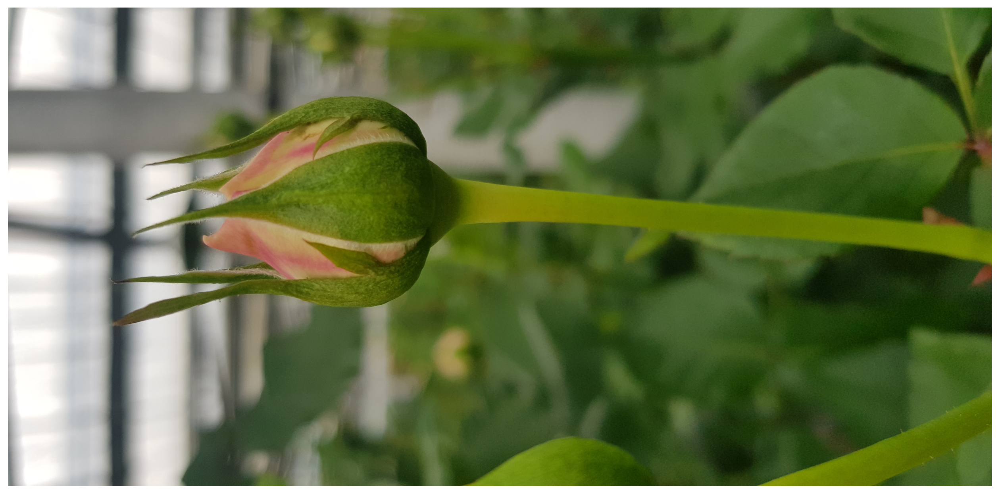

Prediction time per image: 3s 


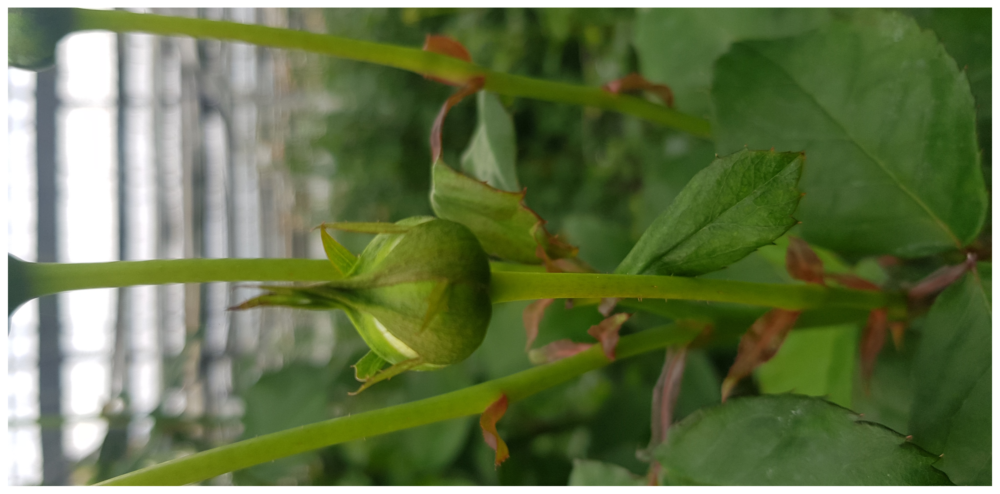

Prediction time per image: 2s 


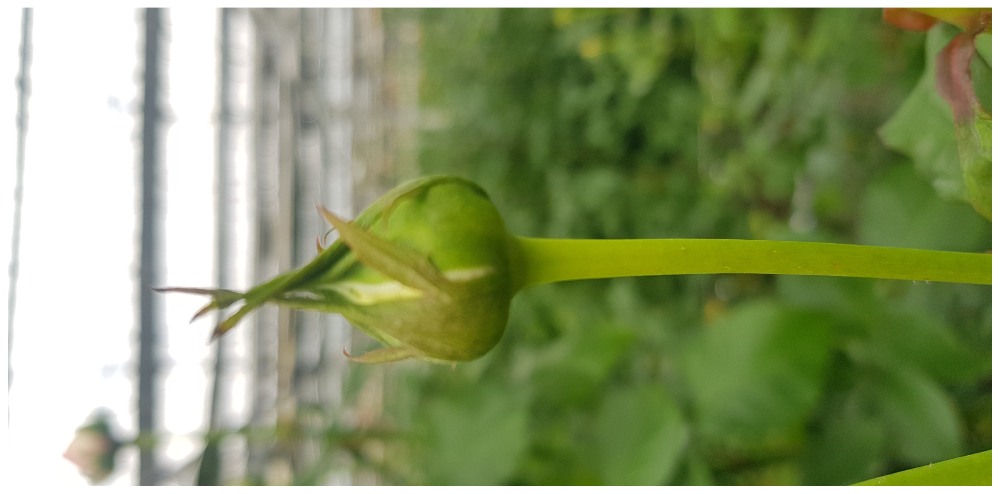

Prediction time per image: 2s 


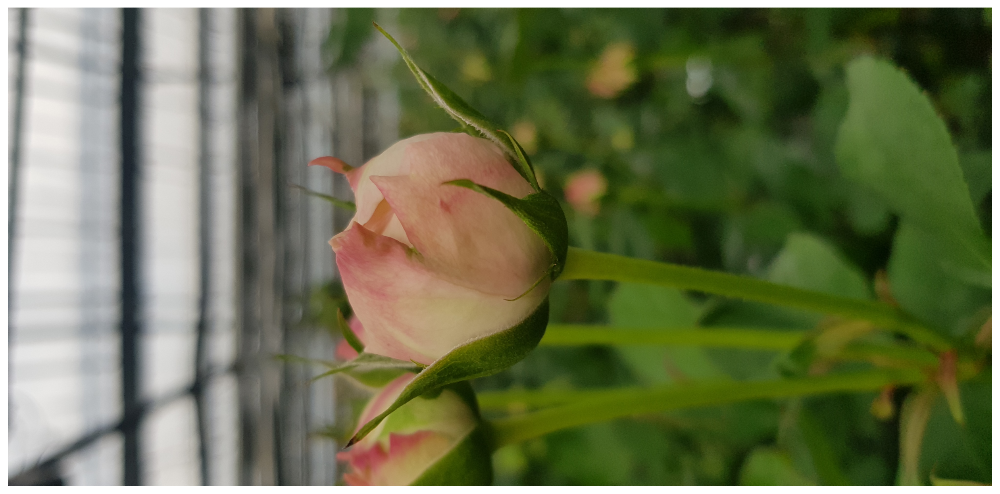

Prediction time per image: 2s 


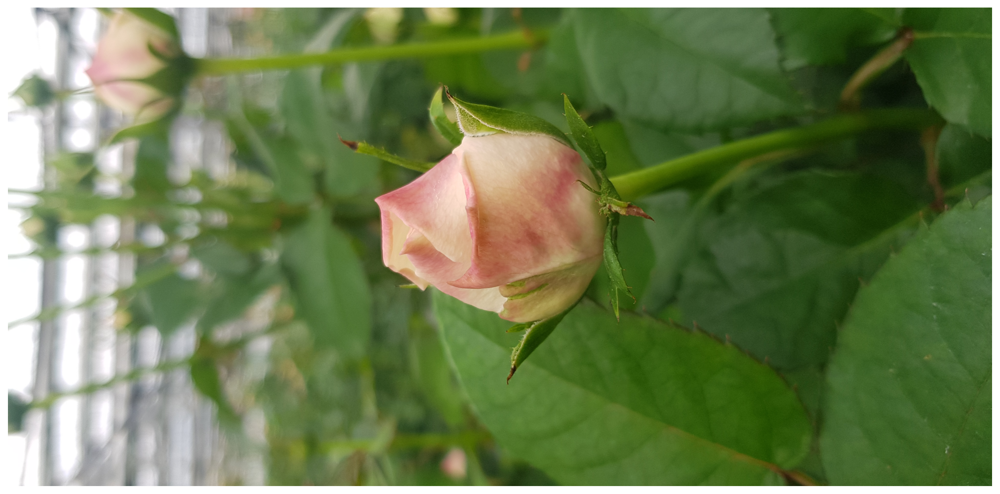

Prediction time per image: 2s 


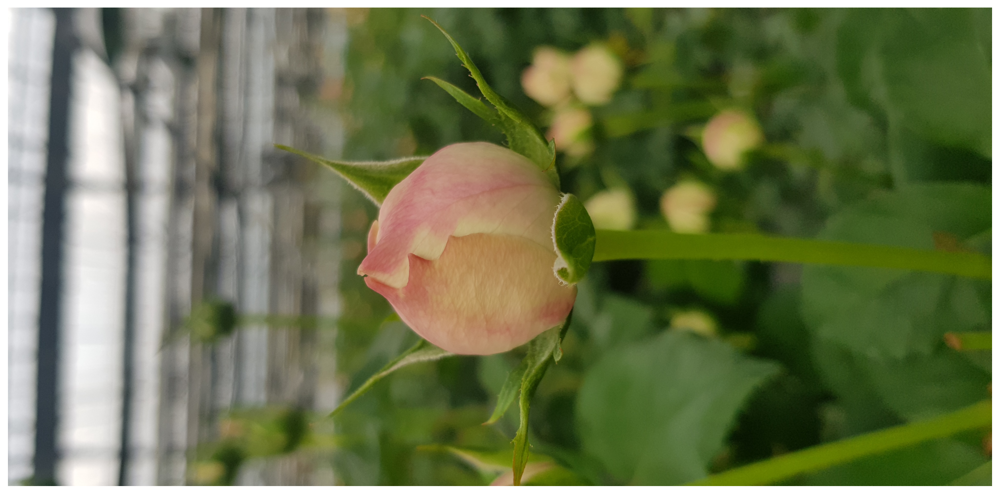

Prediction time per image: 2s 


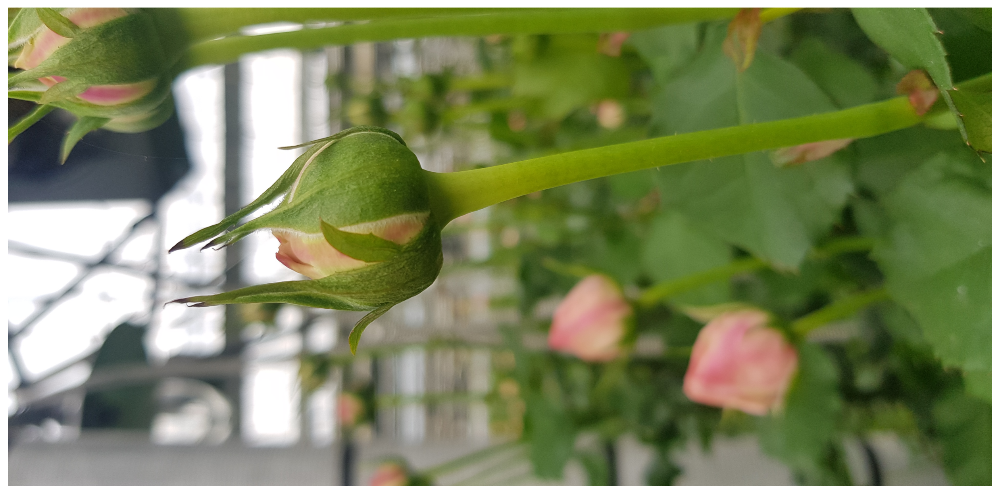

Prediction time per image: 2s 


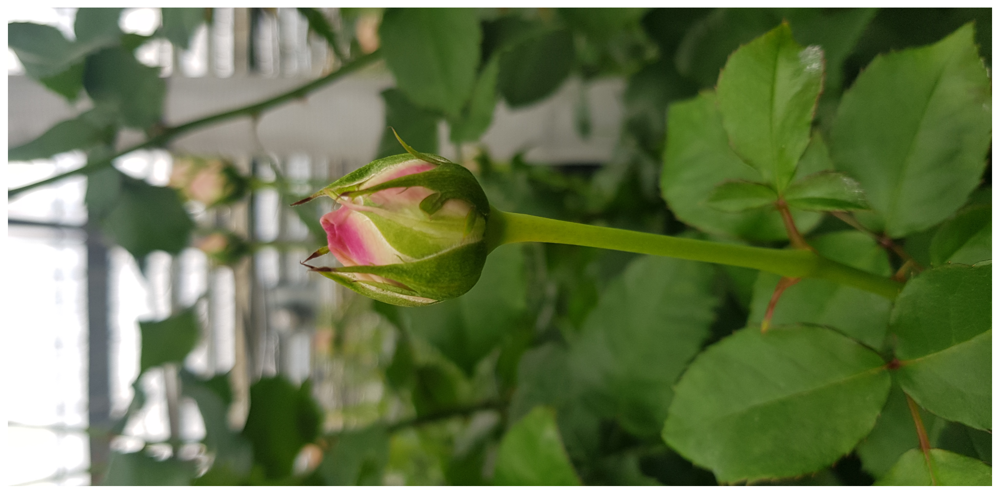

Prediction time per image: 2s 


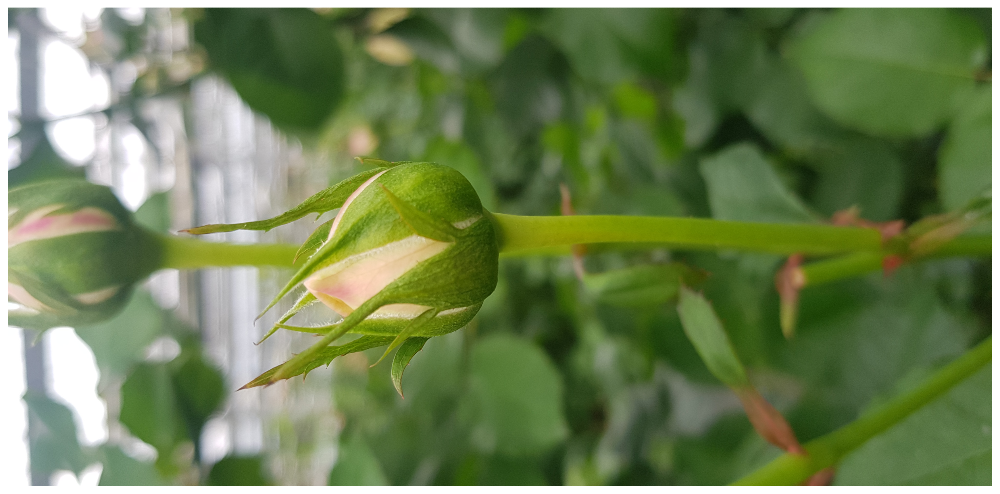

In [22]:
for i in paths[1:10]:
  postprocess_img(i)